# **Top Highlights  📌**

---

1. Surpassed Human-Level accuracy on CIFAR-10.

2. Achieved a final accuracy of **94.19** with a model developed and trained from scratch. 

3. This puts the model in Top 5 of the official Kaggle leaderboard for CIFAR-10.

---



# **Assignment Layout 📎**

The assignment has been divided into five major sections:

---



1.   **Exploring the Data:** Visual inspection of CIFAR-10 along with decisions regarding augmentation parameters. 

2.   **State-of-the-art:** A quick brief on the state-of-the-art on CIFAR-10.

3.   **Ground Zero:** We establish a baseline model, train the model, try out strategies to improve the model, take a look at how different hyperparameters affect the accuracy, after which we will improve it in the subsequent section. 

4.   **Model 2.0:** Summarizing all the conclusions from the previous sections, we will try to build a better model to push our accuracy up.

5.   **Conclusions:** Final thoughts and future improvements. 

---



In [ ]:
!pip install -q -U keras-tuner

In [ ]:
import tensorflow as tf
import tensorflow_addons as tfa
import kerastuner as kt
import numpy as np
import os
import datetime
import matplotlib.pyplot as plt
import seaborn as sns

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.models import load_model
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, GlobalAveragePooling2D, Dense, Activation, Dropout, Flatten, BatchNormalization, PReLU, Concatenate, ReLU, SpatialDropout2D
from tensorflow.keras.activations import swish
from tensorflow.keras.models import Sequential
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ModelCheckpoint
from tensorflow.keras.callbacks import ReduceLROnPlateau
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.utils import plot_model
from sklearn.model_selection import train_test_split

from google.colab import drive
drive.mount('/content/drive')

!nvidia-smi

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Tue Sep  1 09:22:33 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.66       Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+------

## **Exploring CIFAR-10 👀**


---

*   In this section, we will explore the CIFAR-10 dataset visually. 
*   We will also see the effect various augmentations have on the dataset and decide which ones to include


---







### **Loading the dataset**

In [ ]:
# load dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()

170500096/170498071 [==============================] - 12s 0us/step


### **Checking the shapes**

In [ ]:
# verify shapes
print('Shape of training data is (training examples, height, width, channels) {}'.format(x_train.shape))
print('Shape of test data is (test examples, height, width, channels) {}'.format(x_test.shape))

Shape of training data is (training examples, height, width, channels) (50000, 32, 32, 3)
Shape of test data is (test examples, height, width, channels) (10000, 32, 32, 3)


### **Looking at some examples**

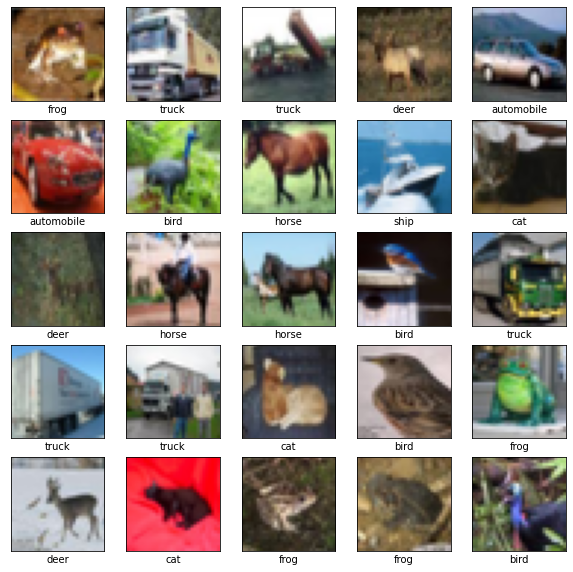

In [ ]:
class_names = ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

plt.figure(figsize=(10,10))
for i in range(25):
    plt.subplot(5,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.grid(False)
    plt.imshow(x_train[i], cmap=plt.cm.binary)
    plt.xlabel(class_names[y_train[i][0]])
plt.show()

### **Exploring various augmentations**

In [ ]:
# sanity check augmentations
train_datagen = ImageDataGenerator(
        rescale= 1/255.0,
        rotation_range=30,
        width_shift_range=0.15,
        height_shift_range=0.15,
        brightness_range = (0.8, 1),
        zoom_range=0.15,
        horizontal_flip=True,
        fill_mode='nearest'
        )

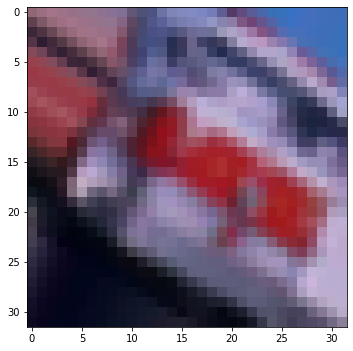

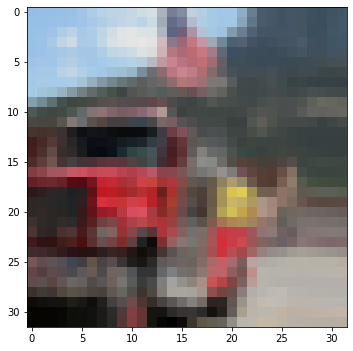

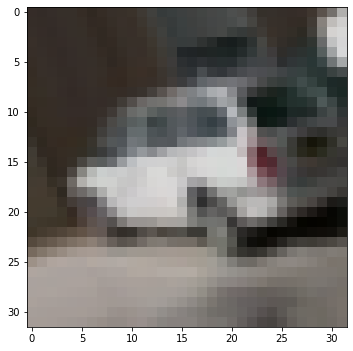

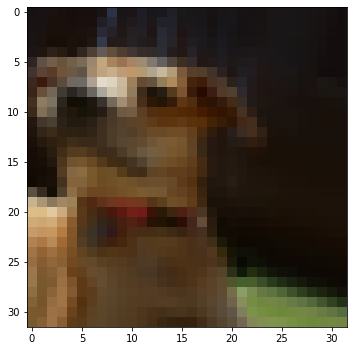

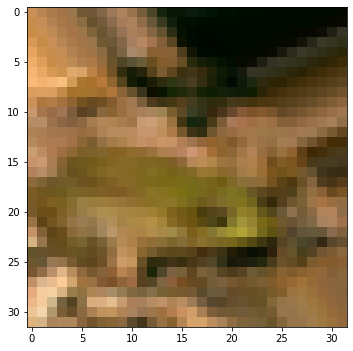

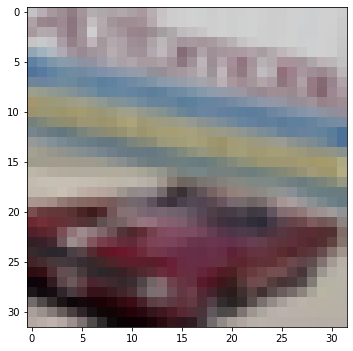

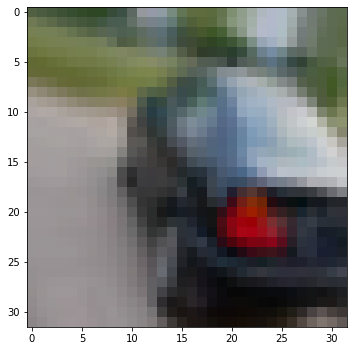

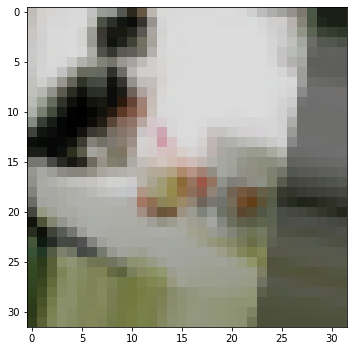

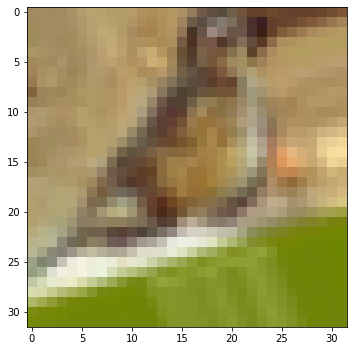

In [ ]:
# configure batch size and retrieve one batch of images
for X_batch, y_batch in train_datagen.flow(x_train, y_train, batch_size=9):
  # create a grid of 3x3 images
  for i in range(0, 9):
    plt.figure(figsize=(20, 20))
    plt.subplot(330 + 1 + i)
    plt.imshow(X_batch[i])
	  # show the plot
    plt.show()
  break

#### **Conclusions**



---



*   Augmentations like ZCA whitening and colour jittering heavily distort the dataset (which is already very blurry), hence we exempt those from our pipeline.

*   The ranges for all the other augmentations such as width and height translations etc, have been chosen empirically making sure that it does not distort the data.

*   We also use standardization instead of simple rescaling since many of the state-of-the-art papers prefer standardization for CIFAR-10 (like Wide ResNet) and also having empirically tested that the standardization works better than rescaling. 





---





## **State-of-the-art 🤯**


---

*   The state-of-the-art on CIFAR-10 has 99.7% accuracy and is a ResNet based model called BiT (Big Transfer) by Google Brain.

*   This model first trains on a huge dataset of ~300M examples, along with other dataset having ~1M examples before trainig on CIFAR-10.

*   The other models that have surpassed the 95% accuracy mark are mostly WideResNet based architectures with more than 10M parameters at the minimum. 

---








## **Ground Zero: The Baseline Model ⚓️**


---



*   A good starting is always to use Transfer Learning or borrow from the state-of-the-art models directly. 

*   But since we have to write our own model from scratch, the architecture used in the Fashion-MNIST problem seems like a good starting point since it beat several benchmarks in its category. 

*   The architecture is a blocked architecture with each block having 2 convolutional layers with feature maps concatenated. 


---




### **Start fresh, and one hot encode the labels**

In [ ]:
# load dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()

# one hot encode
y_train = to_categorical(y_train, 10)
y_test = to_categorical(y_test, 10)

# stratified train, val splits
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, stratify=y_train, test_size=0.10)

# verify shapes
print('Shape of training data is (training examples, height, width, channels) {}'.format(x_train.shape))
print('Shape of validation data is (validation examples, height, width, channels) {}'.format(x_val.shape))
print('Shape of test data is (test examples, height, width, channels) {}'.format(x_test.shape))

Shape of training data is (training examples, height, width, channels) (45000, 32, 32, 3)
Shape of validation data is (validation examples, height, width, channels) (5000, 32, 32, 3)
Shape of test data is (test examples, height, width, channels) (10000, 32, 32, 3)


### **Define the input pipeline**

In [ ]:
# input pipeline
train_datagen = ImageDataGenerator(
        featurewise_center=True, 
        featurewise_std_normalization=True,
        rotation_range=30,
        width_shift_range=0.15,
        height_shift_range=0.15,
        brightness_range = (0.8, 1),
        zoom_range=0.15,
        horizontal_flip=True,
        fill_mode='nearest'
        )

train_datagen.fit(x_train)

val_datagen = ImageDataGenerator(
        featurewise_center=True, 
        featurewise_std_normalization=True
        )

val_datagen.fit(x_train)

### **Copy over the model we used for Fashion-MNIST**




In [ ]:
# define model architecture

input = Input(shape=(x_train.shape[1], x_train.shape[2], x_train.shape[3]))

# Block 1
x1_1 = Conv2D(16, (3, 3), padding='same')(input)
x1_1 = BatchNormalization()(x1_1)
x1_1 = swish(x1_1)
x1_2 = Conv2D(16, (3, 3), padding='same')(x1_1)
x1_2 = BatchNormalization()(x1_2)
x1_2 = swish(x1_2)
x = Concatenate(axis=-1)([x1_1, x1_2])
x = MaxPooling2D(pool_size=(2, 2))(x)

# Block 2
x2_1 = Conv2D(32, (3, 3), padding='same')(x)
x2_1 = BatchNormalization()(x2_1)
x2_1 = swish(x2_1)
x2_2 = Conv2D(32, (3, 3), padding='same')(x2_1)
x2_2 = BatchNormalization()(x2_2)
x2_2 = swish(x2_2)
x = Concatenate(axis=-1)([x2_1, x2_2])
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Dropout(0.1)(x)

# Block 3
x3_1 = Conv2D(64, (3, 3), padding='same')(x)
x3_1 = BatchNormalization()(x3_1)
x3_1 = swish(x3_1)
x3_2 = Conv2D(64, (3, 3), padding='same')(x3_1)
x3_2 = BatchNormalization()(x3_2)
x3_2 = swish(x3_2)
x = Concatenate(axis=-1)([x3_1, x3_2])
x = MaxPooling2D(pool_size=(2, 2))(x)
x = Dropout(0.1)(x)


# Reduce dimensionality and Global Average Pooling
reduce_dim = Conv2D(64, (1, 1), padding='same')(x)
reduce_dim = swish(reduce_dim)
gap = GlobalAveragePooling2D()(reduce_dim)
output = Dense(10, activation = 'softmax')(gap)

# Create model
model = Model(inputs=input, outputs=output, name="cifar10_model")

# Model summary
model.summary()

Model: "cifar10_model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 16)   448         input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 16)   64          conv2d[0][0]                     
__________________________________________________________________________________________________
tf_op_layer_Sigmoid (TensorFlow [(None, 32, 32, 16)] 0           batch_normalization[0][0]        
______________________________________________________________________________________

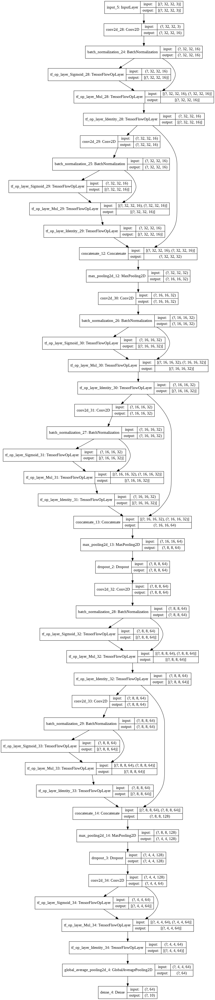

In [ ]:
# visualize the model architecture
plot_model(model, show_shapes=True, show_layer_names=True, to_file='/content/model.png')
from IPython.display import Image
Image(retina=True, filename='/content/model.png')

### **Train the Baseline Model**


---

We will first train the model with default parameters including the learning rate and then inspect the performance.

---







In [ ]:
# Instantiate the optimizer
optimizer = Adam()

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Define  callbacks
checkpoint = ModelCheckpoint(filepath='/content/baseline_cyclic_v1.h5', monitor='val_loss', mode='min', save_best_only=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=1e-6)
early_stop = EarlyStopping(monitor='val_loss', min_delta=0, patience=5, verbose=1, mode='min', restore_best_weights=True)

In [ ]:
# Train the model
history = model.fit(train_datagen.flow(x_train, y_train, shuffle=True), validation_data = val_datagen.flow(x_val, y_val), epochs = 60, callbacks=[checkpoint, reduce_lr, early_stop])

Epoch 1/60
1407/1407 [==============================] - 59s 42ms/step - loss: 1.4865 - accuracy: 0.4616 - val_loss: 1.2717 - val_accuracy: 0.5570
Epoch 2/60
1407/1407 [==============================] - 58s 41ms/step - loss: 1.2040 - accuracy: 0.5716 - val_loss: 1.1466 - val_accuracy: 0.6140
Epoch 3/60
1407/1407 [==============================] - 58s 41ms/step - loss: 1.0860 - accuracy: 0.6184 - val_loss: 0.9703 - val_accuracy: 0.6610
Epoch 4/60
1407/1407 [==============================] - 60s 43ms/step - loss: 1.0007 - accuracy: 0.6483 - val_loss: 0.9820 - val_accuracy: 0.6700
Epoch 5/60
1407/1407 [==============================] - 61s 43ms/step - loss: 0.9398 - accuracy: 0.6716 - val_loss: 0.8791 - val_accuracy: 0.6958
Epoch 6/60
1407/1407 [==============================] - 60s 43ms/step - loss: 0.8952 - accuracy: 0.6894 - val_loss: 0.8847 - val_accuracy: 0.7092
Epoch 7/60
1407/1407 [==============================] - 60s 43ms/step - loss: 0.8516 - accuracy: 0.7021 - val_loss: 0.8499 -

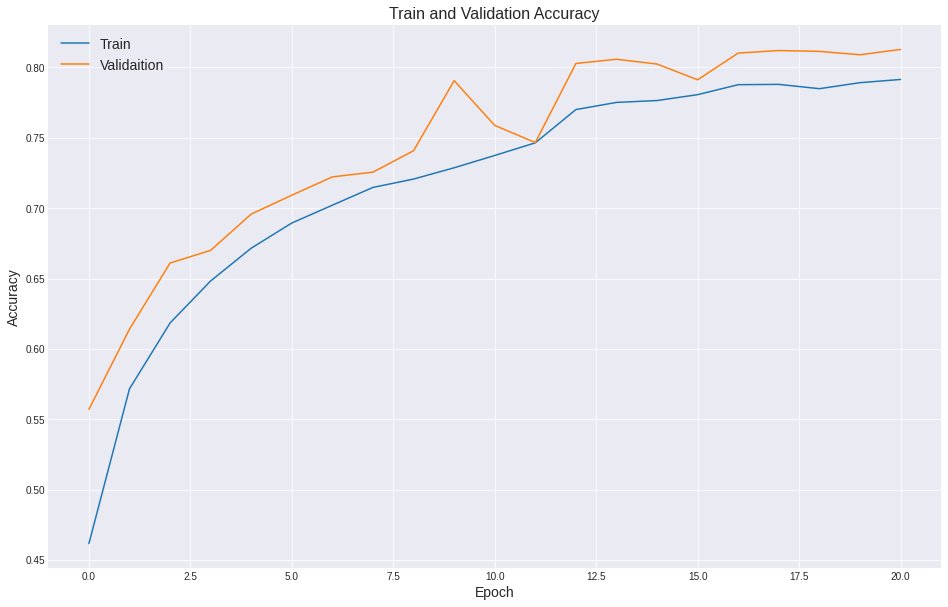

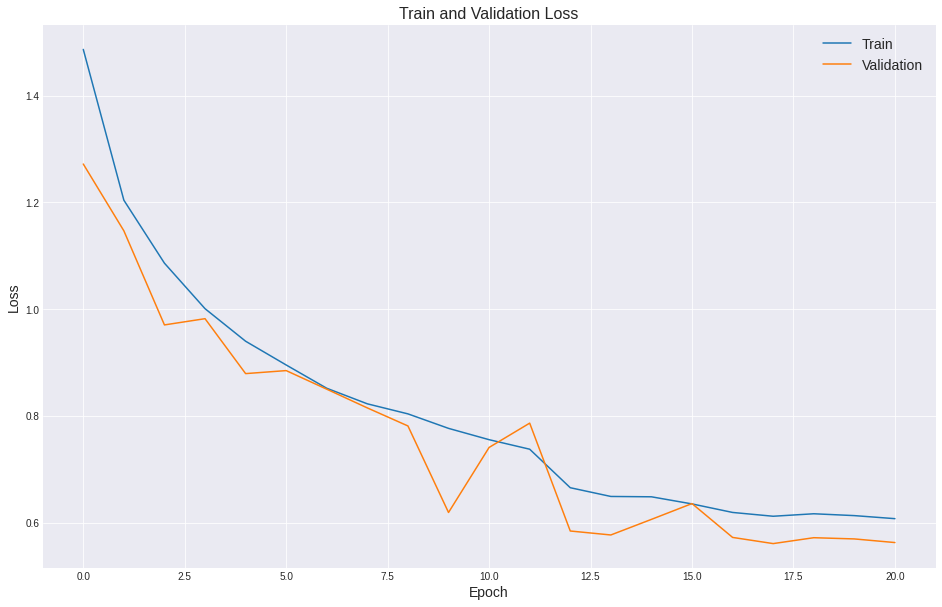

In [ ]:
# train and loss curves

plt.style.use('seaborn-darkgrid')

# Summarize history for accuracy
plt.figure(1, figsize=(16, 10))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train and Validation Accuracy', fontsize = 16)
plt.ylabel('Accuracy', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Validaition'], fontsize = 14)
plt.show()

# Summarize history for loss
plt.figure(2, figsize=(16, 10))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train and Validation Loss', fontsize = 16)
plt.ylabel('Loss', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Validation'], fontsize = 14)
plt.show()

#### **Conclusions**



---

We draw three conclusions, summarised below:


1.   In agreement with the conclusions of the previous vision assignment, because of augmentation, BatchNorm and Dropout the model is not overfitting.

2.   This is evident because there is no divergence in the curves.

3.   However, we do have stagnation at ~81% accuracy which means it would be appropriate to add more expressiveness to the model by increasing the complexity. 


---




### **But first! Does a cylic schedule for learning rate help?**


---


*   Let's try tuning our learning rate.

*   But instead of trying different learning rates, we can try proven advanced methods like the cyclic learning rate scheduler. 

*   It dynamically changes the learning rate every epoch, so that the optimizer can find better minima or come out of a local minima.

---









In [ ]:
import tensorflow_addons as tfa

In [ ]:
# Cylic LR Schedule
lr_schedule = tfa.optimizers.TriangularCyclicalLearningRate(
    initial_learning_rate= 0.0001,
    maximal_learning_rate= 0.001,
    step_size= 20000,
    scale_mode= 'cycle',
    name= 'TriangularCyclicalLearningRate'
)

# Instantiate the optimizer
optimizer = Adam(learning_rate=lr_schedule)

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Define  callbacks
checkpoint = ModelCheckpoint(filepath='/content/baseline_cyclic_v1.h5', monitor='val_loss', mode='min', save_best_only=True)

In [ ]:
# Train the model
history = model.fit(train_datagen.flow(x_train, y_train, shuffle=True), validation_data = val_datagen.flow(x_val, y_val), epochs = 100, callbacks=[checkpoint])

Epoch 1/100
1407/1407 [==============================] - 58s 41ms/step - loss: 1.7172 - accuracy: 0.3851 - val_loss: 1.4457 - val_accuracy: 0.4892
Epoch 2/100
1407/1407 [==============================] - 59s 42ms/step - loss: 1.4346 - accuracy: 0.4868 - val_loss: 1.4232 - val_accuracy: 0.5044
Epoch 3/100
1407/1407 [==============================] - 58s 41ms/step - loss: 1.3144 - accuracy: 0.5300 - val_loss: 1.1711 - val_accuracy: 0.5864
Epoch 4/100
1407/1407 [==============================] - 57s 41ms/step - loss: 1.2307 - accuracy: 0.5616 - val_loss: 1.1539 - val_accuracy: 0.5936
Epoch 5/100
1407/1407 [==============================] - 58s 41ms/step - loss: 1.1737 - accuracy: 0.5851 - val_loss: 1.4050 - val_accuracy: 0.5416
Epoch 6/100
1407/1407 [==============================] - 57s 40ms/step - loss: 1.1177 - accuracy: 0.6084 - val_loss: 1.1931 - val_accuracy: 0.5880
Epoch 7/100
1407/1407 [==============================] - 58s 41ms/step - loss: 1.0703 - accuracy: 0.6228 - val_loss: 1

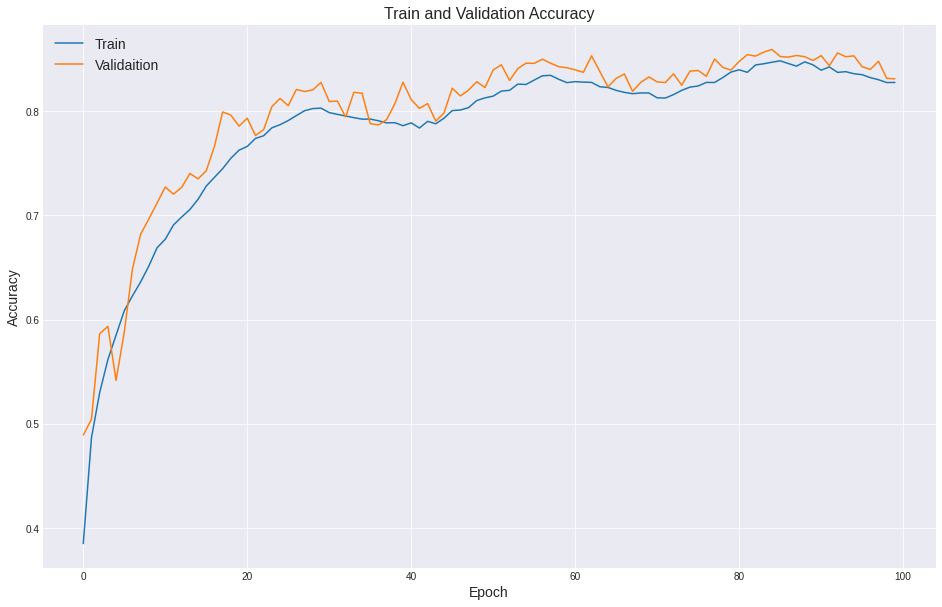

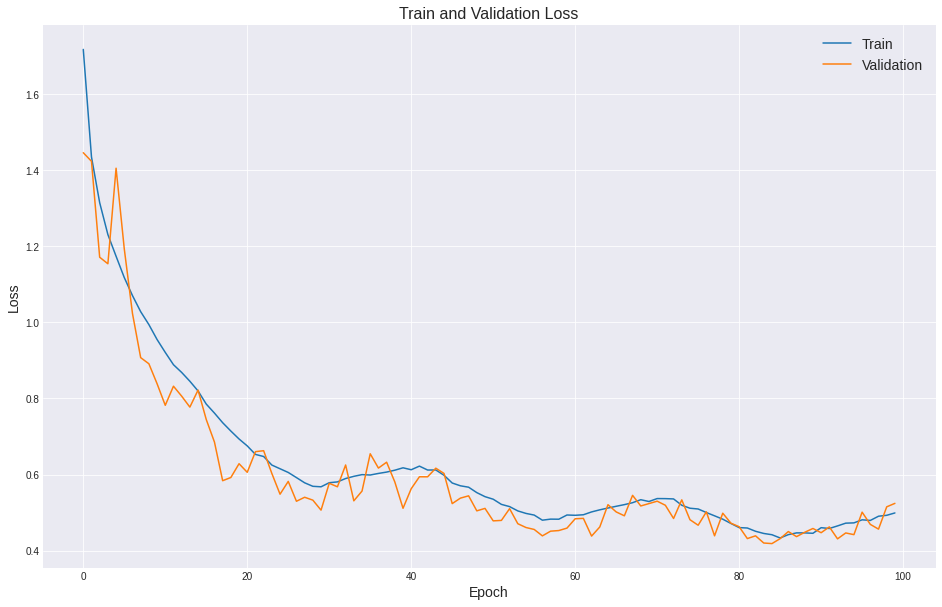

In [ ]:
# train and loss curves

plt.style.use('seaborn-darkgrid')

# Summarize history for accuracy
plt.figure(1, figsize=(16, 10))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train and Validation Accuracy', fontsize = 16)
plt.ylabel('Accuracy', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Validaition'], fontsize = 14)
plt.show()

# Summarize history for loss
plt.figure(2, figsize=(16, 10))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train and Validation Loss', fontsize = 16)
plt.ylabel('Loss', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Validation'], fontsize = 14)
plt.show()

#### **Conclusions**



---

We draw three conclusions, summarised below:


1.   The model trained with a cyclic schedule boosts the performance of our baseline model by ~5%.

2.   We can see the "bumpy" curves which indicates that whenever our model got stuck in a suboptimal minima, the cyclic schedule eventually helped the model out of there (increased learning rate).

3.   However, we do have stagnation at ~86% accuracy which means it would be appropriate to add more expressiveness to the model by increasing the complexity. 


---




### **Smarter Regularization: Spatial Dropouts 💡**


---

*   The baseline model uses the conventional dropout where some weights (hence pixels) are randomly zeroed out. 

*   But since the intuition behind our model is be to able reuse feature maps from previous layers, we want to make sure that the feature maps don't end up being too correlated (and hence reduntant) 

*   It would perhaps make more sense to drop entire feature maps so as to increase the robustness of the model.

*   We can do this by using `SpatialDropout2D` 

*   In general, for a convolution neural network, Spatial Dropouts seem to be a superior choice (more arguments and results are in https://arxiv.org/pdf/1411.4280.pdf)



---












In [ ]:
# define model architecture
input = Input(shape=(x_train.shape[1], x_train.shape[2], x_train.shape[3]))

# Block 1
x1_1 = Conv2D(32, (3, 3), padding='same')(input)
x1_1 = BatchNormalization()(x1_1)
x1_1 = swish(x1_1)
x1_2 = Conv2D(32, (3, 3), padding='same')(x1_1)
x1_2 = BatchNormalization()(x1_2)
x1_2 = swish(x1_2)
x = Concatenate(axis=-1)([x1_1, x1_2])
x = MaxPooling2D(pool_size=(2, 2))(x)
x = SpatialDropout2D(0.1)(x)

# Block 2
x2_1 = Conv2D(64, (3, 3), padding='same')(x)
x2_1 = BatchNormalization()(x2_1)
x2_1 = swish(x2_1)
x2_2 = Conv2D(64, (3, 3), padding='same')(x2_1)
x2_2 = BatchNormalization()(x2_2)
x2_2 = swish(x2_2)
x = Concatenate(axis=-1)([x2_1, x2_2])
x = MaxPooling2D(pool_size=(2, 2))(x)
x = SpatialDropout2D(0.1)(x)

# Block 3
x3_1 = Conv2D(128, (3, 3), padding='same')(x)
x3_1 = BatchNormalization()(x3_1)
x3_1 = swish(x3_1)
x3_2 = Conv2D(128, (3, 3), padding='same')(x3_1)
x3_2 = BatchNormalization()(x3_2)
x3_2 = swish(x3_2)
x = Concatenate(axis=-1)([x3_1, x3_2])
x = MaxPooling2D(pool_size=(2, 2))(x)
x = SpatialDropout2D(0.1)(x)


# Reduce dimensionality and Global Average Pooling
reduce_dim = Conv2D(128, (1, 1), padding='same')(x)
reduce_dim = swish(reduce_dim)
gap = GlobalAveragePooling2D()(reduce_dim)
output = Dense(10, activation = 'softmax')(gap)

# Create model
model = Model(inputs=input, outputs=output, name="cifar10_model_spatial_dropout")

# Model summary
model.summary()

Model: "cifar10_model_spatial_dropout"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d_35 (Conv2D)              (None, 32, 32, 32)   896         input_6[0][0]                    
__________________________________________________________________________________________________
batch_normalization_30 (BatchNo (None, 32, 32, 32)   128         conv2d_35[0][0]                  
__________________________________________________________________________________________________
tf_op_layer_Sigmoid_35 (TensorF [(None, 32, 32, 32)] 0           batch_normalization_30[0][0]     
______________________________________________________________________

In [ ]:
# Cylic LR Schedule
lr_schedule = tfa.optimizers.TriangularCyclicalLearningRate(
    initial_learning_rate= 0.0001,
    maximal_learning_rate= 0.001,
    step_size= 20000,
    scale_mode= 'cycle',
    name= 'TriangularCyclicalLearningRate'
)

# Instantiate the optimizer
optimizer = Adam(learning_rate=lr_schedule)

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Define  callbacks
checkpoint = ModelCheckpoint(filepath='/content/baseline_spatial_dropout.h5', monitor='val_loss', mode='min', save_best_only=True)

In [ ]:
# Train the model
history = model.fit(train_datagen.flow(x_train, y_train, shuffle=True), validation_data = val_datagen.flow(x_val, y_val), epochs = 100, callbacks=[checkpoint])

Epoch 1/100
1407/1407 [==============================] - 79s 56ms/step - loss: 1.6823 - accuracy: 0.3859 - val_loss: 1.3305 - val_accuracy: 0.5244
Epoch 2/100
1407/1407 [==============================] - 77s 54ms/step - loss: 1.4221 - accuracy: 0.4911 - val_loss: 1.2842 - val_accuracy: 0.5488
Epoch 3/100
1407/1407 [==============================] - 73s 52ms/step - loss: 1.2904 - accuracy: 0.5381 - val_loss: 1.1207 - val_accuracy: 0.6142
Epoch 4/100
1407/1407 [==============================] - 71s 50ms/step - loss: 1.1881 - accuracy: 0.5797 - val_loss: 0.9558 - val_accuracy: 0.6658
Epoch 5/100
1407/1407 [==============================] - 68s 49ms/step - loss: 1.1027 - accuracy: 0.6108 - val_loss: 0.8722 - val_accuracy: 0.6978
Epoch 6/100
1407/1407 [==============================] - 67s 48ms/step - loss: 1.0280 - accuracy: 0.6412 - val_loss: 0.8037 - val_accuracy: 0.7330
Epoch 7/100
1407/1407 [==============================] - 67s 48ms/step - loss: 0.9712 - accuracy: 0.6608 - val_loss: 0

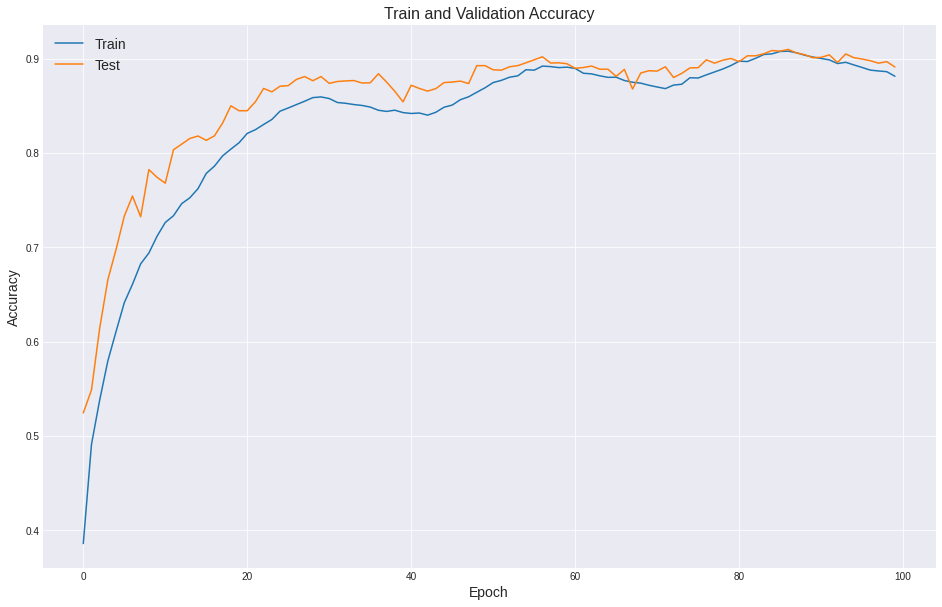

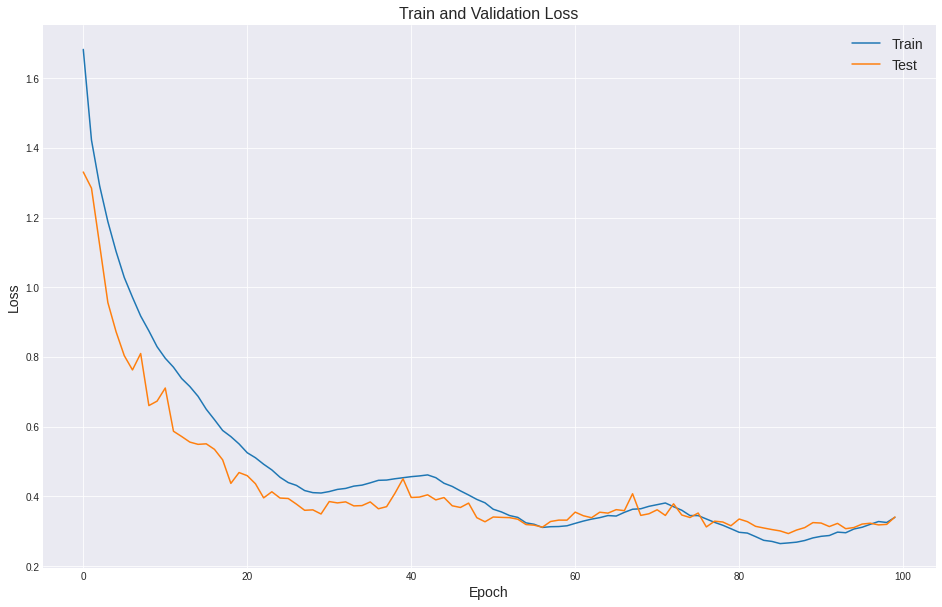

In [ ]:
# train and loss curves

plt.style.use('seaborn-darkgrid')

# Summarize history for accuracy
plt.figure(1, figsize=(16, 10))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train and Validation Accuracy', fontsize = 16)
plt.ylabel('Accuracy', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Test'], fontsize = 14)
plt.show()

# Summarize history for loss
plt.figure(2, figsize=(16, 10))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train and Validation Loss', fontsize = 16)
plt.ylabel('Loss', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Test'], fontsize = 14)
plt.show()

#### **Conclusions**



---



1.   `SpatialDroputs2D` bumps up the performance of our baseline model **from ~81% to ~90%** (without any hyperparameter tuning)

2.    Again, like the previous graph, we see the same characteristic pattern where cyclic learning rate helps find a better minima.


---




### **Does Hyperparameter tuning help? 🔧**



---

We'll use **Keras Tuner** for Hyperparameter Tuning for this section

---






In [ ]:
from kerastuner import HyperModel


class MyHyperModel(HyperModel):

  def __init__(self, num_classes):
    self.num_classes = num_classes

  def build(self, hp):
    inputs = Input(shape=(x_train.shape[1], x_train.shape[2], x_train.shape[3]))
    x = inputs

    for i in range(hp.Int('conv_blocks', 3, 5, default=3)):

      filters = hp.Int('filters_block_' + str(i), 32, 512, step=32)
      kernel_size = hp.Int('kernel_size_block_' + str(i), 3, 5, step=2)

      x1 = Conv2D(filters = filters, kernel_size = kernel_size, padding='same')(x)
      x1 = BatchNormalization()(x1)
      x1 = swish(x1)
      x2 = Conv2D(filters = filters, kernel_size = kernel_size, padding='same')(x1)
      x2 = BatchNormalization()(x2)
      x2 = swish(x2)
      x = Concatenate(axis=-1)([x1, x2])
      x = MaxPooling2D(pool_size=(2, 2))(x)
      x = SpatialDropout2D(hp.Float('dropout', 0, 0.5, step=0.1, default=0.1))(x)
      
  
    reduce_dim = Conv2D(filters = hp.Int('num_dim', 64, 256, step=64), kernel_size= (1, 1), padding='same')(x)
    reduce_dim = swish(reduce_dim)
    gap = GlobalAveragePooling2D()(reduce_dim)
    outputs = Dense(self.num_classes, activation = 'softmax')(gap)

    model = tf.keras.Model(inputs, outputs)
    model.compile(
    optimizer=tf.keras.optimizers.Adam(
      hp.Float('learning_rate', 1e-5, 1e-3, sampling='log')),
    loss='categorical_crossentropy', 
    metrics=['accuracy'])
    return model

hypermodel = MyHyperModel(num_classes=10)

tuner = kt.BayesianOptimization(
            hypermodel,
            objective='val_loss',
            max_trials=2,
            executions_per_trial = 1,
            directory='/content/drive/My Drive',
            project_name='baseline_v1'
        )


tuner.search(train_datagen.flow(x_train, y_train, batch_size = 32),
             epochs=20,
             validation_data= val_datagen.flow(x_val, y_val),
             )

best_model = tuner.get_best_models(num_models=1)[0]
best_model.evaluate(x_test, y_test)

Epoch 1/20
1329/1329 [==============================] - 55s 41ms/step - loss: 1.4095 - accuracy: 0.4951 - val_loss: 1.1327 - val_accuracy: 0.5979
Epoch 2/20
1329/1329 [==============================] - 55s 41ms/step - loss: 0.9840 - accuracy: 0.6516 - val_loss: 1.0135 - val_accuracy: 0.6551
Epoch 3/20
1329/1329 [==============================] - 55s 41ms/step - loss: 0.8300 - accuracy: 0.7097 - val_loss: 0.9094 - val_accuracy: 0.6941
Epoch 4/20
1329/1329 [==============================] - 54s 41ms/step - loss: 0.7324 - accuracy: 0.7439 - val_loss: 1.2747 - val_accuracy: 0.6279
Epoch 5/20
1329/1329 [==============================] - 54s 41ms/step - loss: 0.6643 - accuracy: 0.7679 - val_loss: 0.6398 - val_accuracy: 0.7836
Epoch 6/20
1329/1329 [==============================] - 55s 41ms/step - loss: 0.6139 - accuracy: 0.7890 - val_loss: 0.7251 - val_accuracy: 0.7643
Epoch 7/20
1329/1329 [==============================] - 55s 41ms/step - loss: 0.5714 - accuracy: 0.8017 - val_loss: 0.5931 -

Epoch 1/20
1329/1329 [==============================] - 66s 50ms/step - loss: 1.5877 - accuracy: 0.4159 - val_loss: 1.4543 - val_accuracy: 0.4903
Epoch 2/20
1329/1329 [==============================] - 66s 50ms/step - loss: 1.2081 - accuracy: 0.5662 - val_loss: 1.2486 - val_accuracy: 0.5769
Epoch 3/20
1329/1329 [==============================] - 66s 49ms/step - loss: 1.0224 - accuracy: 0.6358 - val_loss: 0.8986 - val_accuracy: 0.6816
Epoch 4/20
1329/1329 [==============================] - 65s 49ms/step - loss: 0.9153 - accuracy: 0.6778 - val_loss: 0.9971 - val_accuracy: 0.6657
Epoch 5/20
1329/1329 [==============================] - 65s 49ms/step - loss: 0.8288 - accuracy: 0.7092 - val_loss: 0.7813 - val_accuracy: 0.7305
Epoch 6/20
1329/1329 [==============================] - 65s 49ms/step - loss: 0.7685 - accuracy: 0.7306 - val_loss: 0.9070 - val_accuracy: 0.6993
Epoch 7/20
1329/1329 [==============================] - 66s 49ms/step - loss: 0.7145 - accuracy: 0.7495 - val_loss: 0.7632 -

INFO:tensorflow:Oracle triggered exit
313/313 [==============================] - 4s 13ms/step - loss: 134.7415 - accuracy: 0.1428


[134.74154663085938, 0.1428000032901764]

In [ ]:
best_model = tuner.get_best_models(num_models=1)[0]

In [ ]:
best_model.summary()

Model: "functional_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d (Conv2D)                 (None, 32, 32, 192)  14592       input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization (BatchNorma (None, 32, 32, 192)  768         conv2d[0][0]                     
__________________________________________________________________________________________________
tf_op_layer_Sigmoid (TensorFlow [(None, 32, 32, 192) 0           batch_normalization[0][0]        
_______________________________________________________________________________________

In [ ]:
best_model.evaluate(val_datagen.flow(x_test, y_test))

313/313 [==============================] - 4s 13ms/step - loss: 0.4508 - accuracy: 0.8529


[0.45080795884132385, 0.8529000282287598]

In [ ]:
checkpoint = ModelCheckpoint(filepath='/content/drive/My Drive/model_baseline_best_fine_tuned.h5', monitor='val_loss', mode='min', save_best_only=True)
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=2, min_lr=5e-6)
early_stop = EarlyStopping(monitor='val_loss', min_delta=0, patience=3, verbose=1, mode='min', restore_best_weights=True)

history_best_finetuned = best_model.fit(train_datagen.flow(x_train, y_train, batch_size = 32), epochs=60, validation_data= val_datagen.flow(x_val, y_val), callbacks = [checkpoint, reduce_lr, early_stop])

Epoch 1/60
1329/1329 [==============================] - 55s 41ms/step - loss: 0.2440 - accuracy: 0.9156 - val_loss: 0.2433 - val_accuracy: 0.9169
Epoch 2/60
1329/1329 [==============================] - 55s 42ms/step - loss: 0.2220 - accuracy: 0.9237 - val_loss: 0.2305 - val_accuracy: 0.9221
Epoch 3/60
1329/1329 [==============================] - 55s 41ms/step - loss: 0.2187 - accuracy: 0.9240 - val_loss: 0.2291 - val_accuracy: 0.9211
Epoch 4/60
1329/1329 [==============================] - 55s 41ms/step - loss: 0.2119 - accuracy: 0.9266 - val_loss: 0.2239 - val_accuracy: 0.9237
Epoch 5/60
1329/1329 [==============================] - 56s 42ms/step - loss: 0.2086 - accuracy: 0.9279 - val_loss: 0.2208 - val_accuracy: 0.9228
Epoch 6/60
1329/1329 [==============================] - 54s 41ms/step - loss: 0.1989 - accuracy: 0.9309 - val_loss: 0.2362 - val_accuracy: 0.9183
Epoch 7/60
1329/1329 [==============================] - 54s 41ms/step - loss: 0.1899 - accuracy: 0.9336 - val_loss: 0.2359 -

In [ ]:
best_model.evaluate(val_datagen.flow(x_test, y_test))

313/313 [==============================] - 4s 13ms/step - loss: 0.3063 - accuracy: 0.9012


[0.3062766194343567, 0.901199996471405]

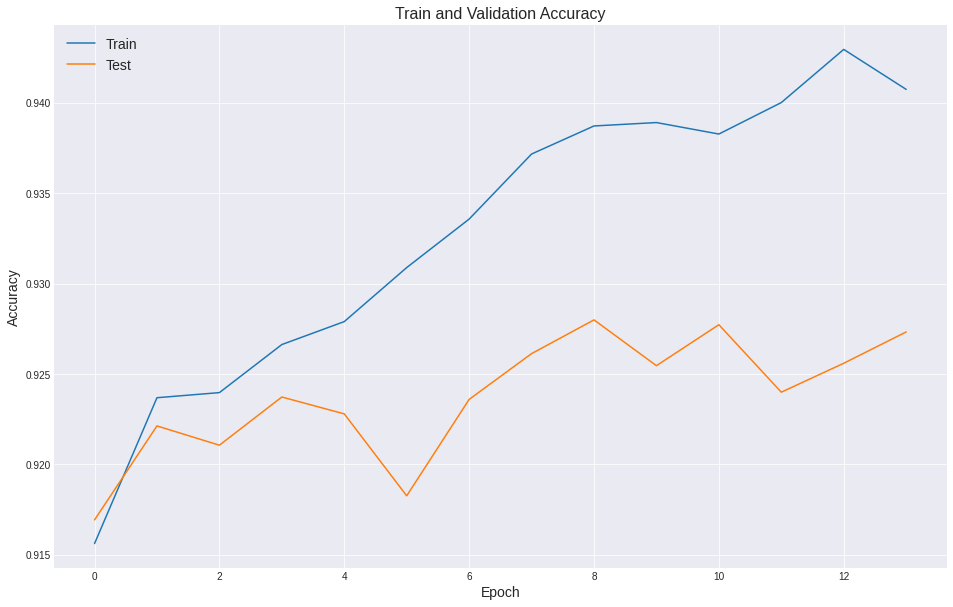

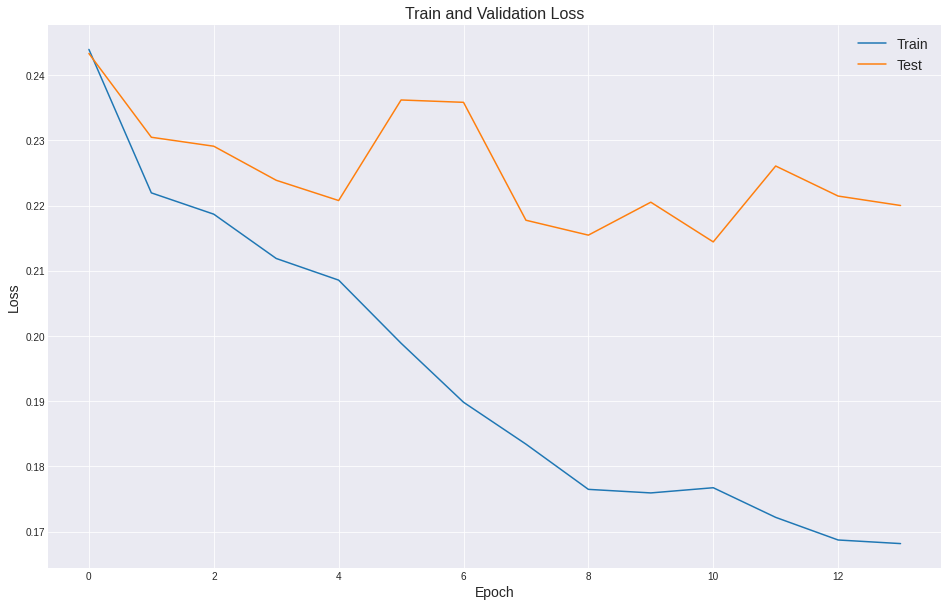

In [ ]:
# train and loss curves
history = history_best_finetuned 
plt.style.use('seaborn-darkgrid')

# Summarize history for accuracy
plt.figure(1, figsize=(16, 10))
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Train and Validation Accuracy', fontsize = 16)
plt.ylabel('Accuracy', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Test'], fontsize = 14)
plt.show()

# Summarize history for loss
plt.figure(2, figsize=(16, 10))
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Train and Validation Loss', fontsize = 16)
plt.ylabel('Loss', fontsize = 14)
plt.xlabel('Epoch', fontsize = 14)
plt.legend(['Train', 'Test'], fontsize = 14)
plt.show()

#### **Conclusions**



---

*   After hyperparameter tuning, the baseline model + `SpatialDropout2D` achieves a validation accuracy of **92.80%.**

*   We observe that the model starts overfitting at some point because of which the validation accuracy stagnates.

*   Since the best model has more layers and units, the complexity of our model has gone up and it starts overfitting.





---





### **Some further inspection 🧐**

It seems like a good time to dive deeper and understand how each parameter in the model affects the metric that we care about.




---

*   Last time we used Keras Tuner for our hyperparameter optimization, in this section we will use Tensorflow's native plugin for visualization.

*   It has several benefits like visualizations to better understand correlations between our parameters.

*   We will visualize how the change in different possible hyperparameters ends up affecting our accuracy.

*   We'll be using Tensorboard's inbuilt plugin for this purpose.


---




In [ ]:
from tensorboard.plugins.hparams import api as hp
import random

# load dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()

# one hot encode
y_train = to_categorical(y_train, 10)
y_test = to_categorical(y_test, 10)

# rescale
x_train = x_train.astype("float32") / 255.0
x_test =  x_test.astype("float32") / 255.0

# stratified train, val splits
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, stratify=y_train, test_size=0.10)

# verify shapes
print('Shape of training data is (training examples, height, width, channels) {}'.format(x_train.shape))
print('Shape of validation data is (validation examples, height, width, channels) {}'.format(x_val.shape))
print('Shape of test data is (test examples, height, width, channels) {}'.format(x_test.shape))

Shape of training data is (training examples, height, width, channels) (45000, 32, 32, 3)
Shape of validation data is (validation examples, height, width, channels) (5000, 32, 32, 3)
Shape of test data is (test examples, height, width, channels) (10000, 32, 32, 3)


In [3]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

In [ ]:
# Define  callbacks
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=3, min_lr=1e-6)


# Define hyperparameters
HP_CONV_FILTERS = hp.HParam("filters", hp.Discrete([32, 64, 128]))
HP_CONV_KERNEL_SIZE = hp.HParam("conv_kernel_size", hp.Discrete([3, 5]))
HP_DROPOUT = hp.HParam("dropout", hp.Discrete([0.1, 0.2]))
HP_OPTIMIZER = hp.HParam('optimizer', hp.Discrete(["adam", "sgd"]))
HP_BATCH_SZ = hp.HParam("batch_sz", hp.Discrete([32, 64, 128, 256]))


HPARAMS = [
    HP_CONV_FILTERS,
    HP_CONV_KERNEL_SIZE,
    HP_DROPOUT,
    HP_OPTIMIZER,
    HP_BATCH_SZ
]

METRIC_ACCURACY = 'accuracy'

In [ ]:
def model_fn(logdir, hparams, seed):
  """Create a Keras model with the given hyperparameters.
  Args:
    hparams: A dict mapping hyperparameters in `HPARAMS` to values.
    seed: A hashable object to be used as a random seed (e.g., to
      construct dropout layers in the model).
  Returns:
    A compiled Keras model.
  """
  rng = random.Random(seed)

  # input layer  
  inputs = Input(shape = (32, 32, 3))

  x = inputs
  
  # Add convolutional layers.
  for _ in range(3):

    # Forward Block
    x1 = Conv2D(filters=hparams[HP_CONV_FILTERS], use_bias = False, kernel_size=hparams[HP_CONV_KERNEL_SIZE], padding="same")(x)
    x1 = BatchNormalization()(x1)
    x1 = swish(x1)
    x2 = Conv2D(filters=hparams[HP_CONV_FILTERS], use_bias = False, kernel_size=hparams[HP_CONV_KERNEL_SIZE], padding="same")(x1)
    x2 = BatchNormalization()(x2)
    x2 = swish(x2)
    x = Concatenate(axis=-1)([x1, x2])
    x = swish(x)
    x = MaxPooling2D(pool_size=(2, 2))(x)
    x = SpatialDropout2D(hparams[HP_DROPOUT], seed=rng.random())(x)


  # Reduce dimensionality and Global Average Pooling
  reduce_dim = Conv2D(128, (1, 1), padding='same')(x)
  reduce_dim = swish(reduce_dim)
  gap = GlobalAveragePooling2D()(reduce_dim)
  output = Dense(10, activation = 'softmax')(gap)

  # Create model
  model = Model(inputs=inputs, outputs=output, name="cifar10_model")

  model.compile(
      loss="categorical_crossentropy",
      optimizer=hparams[HP_OPTIMIZER],
      metrics=["accuracy"],
  )

  model.fit(x_train, y_train, batch_size = hparams[HP_BATCH_SZ], shuffle=True, validation_data = (x_val, y_val), epochs = 1,
  callbacks=[reduce_lr,
        tf.keras.callbacks.TensorBoard(logdir),  # log metrics
        hp.KerasCallback(logdir, hparams),  # log hparams
    ], verbose = 2)

In [ ]:
session_num = 0

for num_filters in HP_CONV_FILTERS.domain.values:
  for kernel_sz in HP_CONV_KERNEL_SIZE.domain.values:
    for dropout_rate in HP_DROPOUT.domain.values:
      for optimizer in HP_OPTIMIZER.domain.values:
        for batch_sz in HP_BATCH_SZ.domain.values:
          hparams = {
                  HP_CONV_FILTERS: num_filters,
                  HP_CONV_KERNEL_SIZE: kernel_sz,
                  HP_DROPOUT: dropout_rate,
                  HP_OPTIMIZER: optimizer,
                  HP_BATCH_SZ: batch_sz
              }
          run_name = "run-%d" % session_num
          print('--- Starting trial: %s' % run_name)
          print({h.name: hparams[h] for h in hparams})
          model_fn('/content/drive/My Drive/logs/hparam_tuning6/' + run_name, hparams, 42)
          session_num += 1

--- Starting trial: run-0
{'filters': 32, 'conv_kernel_size': 3, 'dropout': 0.1, 'optimizer': 'adam', 'batch_sz': 32}
Instructions for updating:
use `tf.profiler.experimental.stop` instead.
1407/1407 - 12s - loss: 1.4188 - accuracy: 0.4770 - val_loss: 1.5230 - val_accuracy: 0.4646
--- Starting trial: run-1
{'filters': 32, 'conv_kernel_size': 3, 'dropout': 0.1, 'optimizer': 'adam', 'batch_sz': 64}
704/704 - 8s - loss: 1.4744 - accuracy: 0.4542 - val_loss: 1.2098 - val_accuracy: 0.5456
--- Starting trial: run-2
{'filters': 32, 'conv_kernel_size': 3, 'dropout': 0.1, 'optimizer': 'adam', 'batch_sz': 128}
352/352 - 7s - loss: 1.5108 - accuracy: 0.4422 - val_loss: 2.6195 - val_accuracy: 0.2158
--- Starting trial: run-3
{'filters': 32, 'conv_kernel_size': 3, 'dropout': 0.1, 'optimizer': 'adam', 'batch_sz': 256}
176/176 - 7s - loss: 1.6068 - accuracy: 0.4062 - val_loss: 3.5159 - val_accuracy: 0.1000
--- Starting trial: run-4
{'filters': 32, 'conv_kernel_size': 3, 'dropout': 0.1, 'optimizer': '

In [7]:
%tensorboard --logdir '/content/drive/My Drive/logs/hparam_tuning6' --port 6007

Output hidden; open in https://colab.research.google.com to view.

#### **Conclusions**


---

1.   We can see that clearly Adam optimize is a better choice than SGD which also a popular option. 

2.   We also see that a kernel size whether it is 3x3 or 5x5, both are almost equal in performance.

3.   Batch sizes 32 and 64 out of the other sizes seem to give the best results.

4.   In line with our original hypothesis of "adding more expressiveness" to the model, it seems increasing the filter size seems to help the accuracy.



---







## **Reinventing: Model 2.0 🚀**



---

**Things we verifed upto now:**


*   Since our hyperparameter tuned model does 92.80%, we can confirm that the basic intuition of our model (sharing feature maps across layers) seems to definitely work well. 

*   We also verified that swapping `Dropout` layers for `SpatialDropout2D` layers seems to work well for the model.

*   We also verified a dynamic learning rate schedule works better for our dataset than a constant learning rate with reduce on plateau strategy. 

*   We also verified that increasing the number of filters will help us but increasing the kernel size does not affect the performace.


**Where do we go from here?** 

*   Based on our previous observations, we can extend upon our original intuition of feature map concatenation by increasing the filter size. 

*   We can also try add more layers in the block and also going deeper by adding more blocks (the hyperparameter tuned model showed us this).

*   However, at the same time, we would like to restrict our number of parameters so we will add compression layers between the blocks to manage the complexity of our model. 

*   Since Adam optimizer works well, we can also try a variant of the Adam optimizer (like AdamW and Rectified Adam with a Look Ahead strategy) which have been shown to be working well in the recent literature.

---







In [ ]:
# load dataset
(x_train, y_train), (x_test, y_test) = tf.keras.datasets.cifar10.load_data()

# one hot encode
y_train = to_categorical(y_train, 10)
y_test = to_categorical(y_test, 10)
#x_train = x_train.astype('float32') / 255.0
#x_test = x_test.astype('float32') / 255.0

# stratified train, val splits
x_train, x_val, y_train, y_val = train_test_split(x_train, y_train, stratify=y_train, test_size=0.10)


# verify shapes
print('Shape of training data is (training examples, height, width, channels) {}'.format(x_train.shape))
print('Shape of validation data is (training examples, height, width, channels) {}'.format(x_val.shape))
print('Shape of test data is (test examples, height, width, channels) {}'.format(x_test.shape))

170500096/170498071 [==============================] - 4s 0us/step
Shape of training data is (training examples, height, width, channels) (45000, 32, 32, 3)
Shape of validation data is (training examples, height, width, channels) (5000, 32, 32, 3)
Shape of test data is (test examples, height, width, channels) (10000, 32, 32, 3)


In [ ]:
# sanity check augmentations
train_datagen = ImageDataGenerator(
        featurewise_center=True, 
        featurewise_std_normalization=True,
        rotation_range=30,
        width_shift_range=0.15,
        height_shift_range=0.15,
        brightness_range = (0.8, 1),
        zoom_range=0.15,
        horizontal_flip=True,
        fill_mode='nearest'
        )

train_datagen.fit(x_train)

val_datagen = ImageDataGenerator(
        featurewise_center=True, 
        featurewise_std_normalization=True
        )

val_datagen.fit(x_train)

In [ ]:
# define model architecture

input = Input(shape=(x_train.shape[1], x_train.shape[2], x_train.shape[3]))

# Block 1
x1_1 = Conv2D(64, (3, 3), use_bias = False, padding='same')(input)
x1_1 = BatchNormalization()(x1_1)
x1_1 = swish(x1_1)
x1_2 = Conv2D(64, (3, 3), use_bias = False, padding='same')(x1_1)
x1_2 = BatchNormalization()(x1_2)
x1_2 = swish(x1_2)
x1_3 = Conv2D(64, (3, 3), use_bias = False, padding='same')(x1_2)
x1_3 = BatchNormalization()(x1_3)
x1_3 = swish(x1_3)
x = Concatenate(axis=-1)([x1_1, x1_2, x1_3])
x = swish(x)
x = MaxPooling2D((2,2))(x)
x = SpatialDropout2D(0.3)(x)


# Transistion Block
reduce_x = Conv2D(128, (1, 1), use_bias = False, padding='same')(x)
reduce_x = BatchNormalization()(reduce_x)
reduce_x = swish(reduce_x)


# Block 2
x2_1 = Conv2D(128, (3, 3), use_bias = False, padding='same')(reduce_x)
x2_1 = BatchNormalization()(x2_1)
x2_1 = swish(x2_1)
x2_2 = Conv2D(128, (3, 3), use_bias = False, padding='same')(x2_1)
x2_2 = BatchNormalization()(x2_2)
x2_2 = swish(x2_2)
x2_3 = Conv2D(128, (3, 3), use_bias = False, padding='same')(x2_2)
x2_3 = BatchNormalization()(x2_3)
x2_3 = swish(x2_3)
x = Concatenate(axis=-1)([x2_1, x2_2, x2_3])
x = BatchNormalization()(x)
x = swish(x)
x = MaxPooling2D((2,2))(x)
x = SpatialDropout2D(0.3)(x)


# Transistion Block
reduce_x = Conv2D(256, (1, 1), use_bias = False, padding='same')(x)
reduce_x = BatchNormalization()(reduce_x)
reduce_x = swish(reduce_x)


# Block 3
x3_1 = Conv2D(256, (3, 3), use_bias = False, padding='same')(reduce_x)
x3_1 = BatchNormalization()(x3_1)
x3_1 = swish(x3_1)
x3_2 = Conv2D(256, (3, 3), use_bias = False, padding='same')(x3_1)
x3_2 = BatchNormalization()(x3_2)
x3_2 = swish(x3_2)
x3_3 = Conv2D(256, (3, 3), use_bias = False, padding='same')(x3_2)
x3_3 = BatchNormalization()(x3_3)
x3_3 = swish(x3_3)
x = Concatenate(axis=-1)([x3_1, x3_2, x3_3])
x = BatchNormalization()(x)
x = swish(x)
x = MaxPooling2D((2,2))(x)
x = SpatialDropout2D(0.3)(x)


# Transistion Block
reduce_x = Conv2D(512, (1, 1), use_bias = False, padding='same')(x)
reduce_x = BatchNormalization()(reduce_x)
reduce_x = swish(reduce_x)


# Block 4
x4_1 = Conv2D(256, (3, 3), use_bias = False, padding='same')(reduce_x)
x4_1 = BatchNormalization()(x4_1)
x4_1 = swish(x4_1)
x4_2 = Conv2D(256, (3, 3), use_bias = False, padding='same')(x4_1)
x4_2 = BatchNormalization()(x4_2)
x4_2 = swish(x4_2)
x4_3 = Conv2D(256, (3, 3), use_bias = False, padding='same')(x4_2)
x4_3 = BatchNormalization()(x4_3)
x4_3 = swish(x4_3)
x = Concatenate(axis=-1)([x4_1, x4_2, x4_3])
x = BatchNormalization()(x)
x = swish(x)
x = MaxPooling2D((2,2))(x)
x = SpatialDropout2D(0.3)(x)



# Reduce dimensionality and Global Average Pooling
reduce_dim = Conv2D(512, (1, 1), use_bias = False, padding='same')(x)
reduce_dim = BatchNormalization()(reduce_dim)
reduce_dim = swish(reduce_dim)
gap = GlobalAveragePooling2D()(reduce_dim)
output = Dense(10, activation = 'softmax')(gap)

# Create model
model = Model(inputs=input, outputs=output, name="cifar10_model_final")

# Model summary
model.summary()

Model: "cifar10_model_final"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 32, 32, 3)]  0                                            
__________________________________________________________________________________________________
conv2d_32 (Conv2D)              (None, 32, 32, 64)   1728        input_3[0][0]                    
__________________________________________________________________________________________________
batch_normalization_38 (BatchNo (None, 32, 32, 64)   256         conv2d_32[0][0]                  
__________________________________________________________________________________________________
tf_op_layer_Sigmoid_40 (TensorF [(None, 32, 32, 64)] 0           batch_normalization_38[0][0]     
________________________________________________________________________________

In [ ]:
# visualize the model architecture
plot_model(model, show_shapes=True, show_layer_names=True, to_file='/content/model.png')
from IPython.display import Image
Image(retina=True, filename='/content/model.png')

In [ ]:
# Load the TensorBoard notebook extension
%load_ext tensorboard

# set logs path
log_dir = "/content/drive/My Drive/logs_final/fit/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [ ]:
# Instantiate the optimizer
radam = tfa.optimizers.RectifiedAdam()
optimizer = tfa.optimizers.Lookahead(radam, sync_period=6, slow_step_size=0.5)

# Compile the model
model.compile(loss='categorical_crossentropy', optimizer=optimizer, metrics=['accuracy'])

# Define  callbacks
checkpoint = ModelCheckpoint(filepath='/content/drive/My Drive/final_94.h5', monitor='val_accuracy', mode='max', save_best_only=True)
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=log_dir, histogram_freq=1)

In [ ]:
# Train the model
history = model.fit(train_datagen.flow(x_train, y_train, shuffle=True), validation_data = val_datagen.flow(x_val, y_val), epochs = 200, callbacks=[checkpoint, tensorboard_callback])

Epoch 1/200
1407/1407 [==============================] - 85s 60ms/step - loss: 1.7847 - accuracy: 0.3444 - val_loss: 1.3453 - val_accuracy: 0.5072
Epoch 2/200
1407/1407 [==============================] - 83s 59ms/step - loss: 1.3787 - accuracy: 0.5038 - val_loss: 1.1262 - val_accuracy: 0.6140
Epoch 3/200
1407/1407 [==============================] - 83s 59ms/step - loss: 1.1491 - accuracy: 0.5956 - val_loss: 1.0450 - val_accuracy: 0.6504
Epoch 4/200
1407/1407 [==============================] - 83s 59ms/step - loss: 1.0136 - accuracy: 0.6498 - val_loss: 0.8097 - val_accuracy: 0.7248
Epoch 5/200
1407/1407 [==============================] - 83s 59ms/step - loss: 0.9210 - accuracy: 0.6814 - val_loss: 0.8194 - val_accuracy: 0.7278
Epoch 6/200
1407/1407 [==============================] - 83s 59ms/step - loss: 0.8507 - accuracy: 0.7081 - val_loss: 0.6218 - val_accuracy: 0.7852
Epoch 7/200
1407/1407 [==============================] - 83s 59ms/step - loss: 0.7922 - accuracy: 0.7268 - val_loss: 0

KeyboardInterrupt: ignored

In [ ]:
%tensorboard --logdir '/content/drive/My Drive/logs_final/fit/'

Output hidden; open in https://colab.research.google.com to view.

## **Conclusion ⚖️**


---

1.   With **5.5M** parameters, we are able to achieve **94.08%** accuracy on CIFAR-10 in **~110 epochs** which matches the [human-level accuracy on this dataset (Karpathy)](http://karpathy.github.io/2011/04/27/manually-classifying-cifar10/).

2.   The approach of **sharing feature maps across layers instead of a unidirectional flow** seems to be a really powerful idea for vision problems since it worked well on two datasets for us. 

3.   We can be confident that **with hyperparameter tuning and more training time, Model 2.0 architecture we would have definitely crossed 95%**, however it was too computationally expensive to explore, but will definitely be worked upon in the future.

4.  Different optimizers were explored and the conclusion is that some of the newer optimizers which are an extension to Adam work really well resulting in **faster convergence and a better minima.**

5.  While a larger kernel size bumps up the performace initially a little bit at the cost of **~1.4x** parameters increase per kernel, towards the end it fails to outperform a 3x3 kernel 


**Observations worth a mention:**

1.  Dilated convolutions were tested (with dilation rates of 2 and 3) but they seem to degrade performance most probably because at ~5.5M parameters, our model is sparse enough and any **further deprievation of information leads to underfitting**

2.  Apart from Adam and SGD, RMSProp was also experimented with, but it was outperformed by default Adam.

3.  Visual Attention based architectures like the [Spatial Transformer Network](https://arxiv.org/pdf/1506.02025.pdf) by DeepMind was experimented with, however it resulted in significantly lower accuracy of **~86%.** 




---







